In [1]:
#%matplotlib inline
%load_ext autoreload
%autoreload 2

import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from torchvision import datasets, transforms
import glob
#import pandas as pd
import time
import random
import copy
from copy import deepcopy
import threading

import os 
import shutil
from PIL import Image
import multiprocessing as mp
import math
import matplotlib.pyplot as plt
import random

from IPython.core.display import Image as JupyterImage
from torchvision.utils import save_image

from train_utils import *

import gym3
from procgen import ProcgenGym3Env

In [2]:
device = 'cuda'

In [3]:
bs = 4
env = ProcgenGym3Env(num=bs, env_name="testgame", num_levels=500) # render_mode='rgb_array'
#env = gym3.ViewerWrapper(env, info_key="rgb")

building procgen...done


In [4]:
%%time

s = np.array([np.array([.1,.1]) for _ in range(bs)], dtype=np.float32)
seq_len = 20

for i in range(seq_len):
    env.act(s)
    rew, obs, first = env.observe()
    img = obs['rgb']
    info = env.get_info()

    angle_to_wp = np.array([np.array([e['angle_to_wp']]) for e in info])
    #steer = np.array([e['autopilot_steer'] for e in info])

    front = torch.from_numpy(img.astype(np.float32)/255.).unsqueeze(0).permute(0,1,4,2,3).to(device)
    aux = torch.from_numpy(angle_to_wp.astype(np.float32)).unsqueeze(0).to(device)

CPU times: user 1.16 s, sys: 433 ms, total: 1.59 s
Wall time: 1.61 s


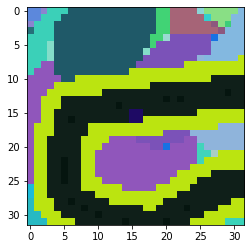

In [5]:
plt.imshow(img[0])

In [6]:
dataloader = DataLoader(env=env, bs=bs)

In [7]:
front_container, aux_container, control_container = dataloader.get_chunk()

In [8]:
front_container.shape, aux_container.shape

(torch.Size([400, 4, 3, 32, 32]), torch.Size([400, 4, 5]))

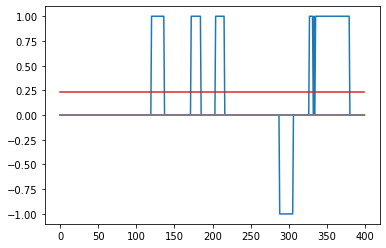

In [9]:
plt.plot(aux_container[:,0,:])

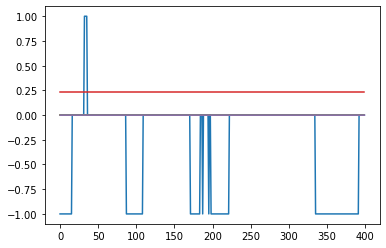

In [10]:
plt.plot(aux_container[:,3,:])

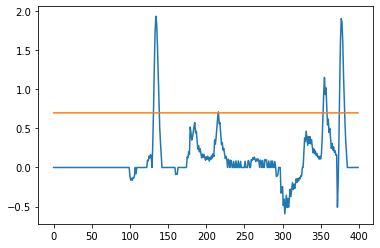

In [11]:
plt.plot(control_container[:,0,:])

### Making an overlaid video w controls

In [13]:

from skimage.transform import resize
import cv2

In [14]:
def control_chart_as_np(c):

    fig = plt.figure();
    ax = fig.add_subplot(111);
    _ = ax.bar(x = control_properties+["angle_to_wp"], height=c);
    fig.canvas.draw();
    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='');
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,));
    chart = resize(data, (IMG_SZ, IMG_SZ, 3));
    return chart

In [15]:
c = list(control_container[0,0,:].numpy()) + list(aux_container[0,0,:1].numpy())
c

[-0.72673696, 1.907752, 0.0]

/home/beans/anaconda3/envs/procgen/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  import sys


array([[[0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        ...,
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843]],

       [[0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        ...,
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843]],

       [[0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        ...,
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843]],

       ...,

       [[0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0.99607843, 0.99607843],
        [0.99607843, 0

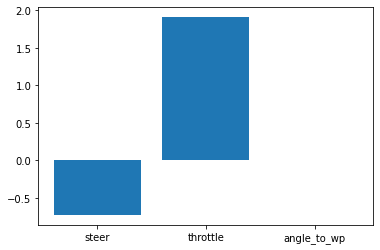

In [16]:
control_chart_as_np(c)

In [17]:
%%capture

results = []

for b_ix in range(bs):
    print(b_ix)
    for i in range(len(front_container)):
        c = control_container[i, b_ix,:]
        a = aux_container[i,b_ix,:1]
        c = list(c.numpy())+list(a.numpy())
        chart = control_chart_as_np(c)
        f = front_container[i,b_ix,:,:,:]
        f = f.permute(1,2,0).numpy()
        r = np.concatenate([f,chart],1)

        r = np.uint8(r*255)

        results.append(r)

In [18]:
img1 = results[0]
height , width , layers = img1.shape
fps = 20

video = cv2.VideoWriter('sequence1.avi', cv2.VideoWriter_fourcc(*"MJPG"), fps, (width,height))

for i in range(len(results)-1):
    img = results[i] # cv2 expects out of 255, integers
    video.write(img)
    
cv2.destroyAllWindows()
video.release()

### Viewing a batch

In [16]:
b_ix = 0
front = front_container[:, :, :, :, :].to(device)
aux = aux_container[:, :, :]
control = control_container[:, :, :]

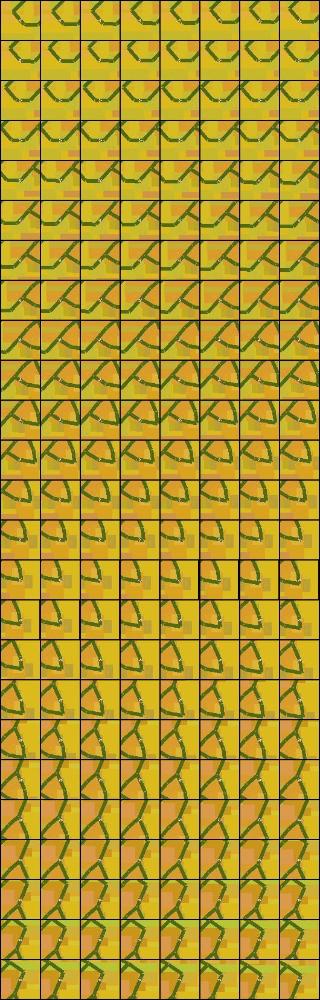

In [17]:
save_image(front[:, b_ix, :, :, :], 'sample_image.png')
JupyterImage('sample_image.png')

In [29]:
control_properties

['brake', 'steer', 'throttle']

(array([ 28.,  14.,   9.,  12.,   9.,  11.,  26.,  28., 736., 327.]),
 array([-0.28344727, -0.24889222, -0.21433716, -0.17978211, -0.14522704,
        -0.110672  , -0.07611694, -0.04156189, -0.00700684,  0.02754822,
         0.06210327], dtype=float32),
 <a list of 10 Patch objects>)

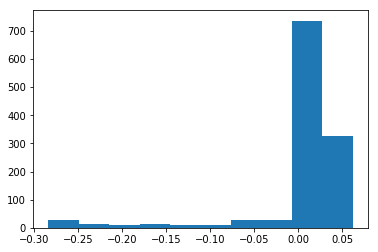

In [30]:
plt.hist(control[:,:,1].view(-1))

In [31]:
np.round(control[:,0,1].numpy(), 1)

array([-0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. ,
       -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. ,
       -0. , -0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,
        0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,
        0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0. , -0.1,
       -0.1, -0.1, -0.1, -0.1, -0.1, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2,
       -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2,
       -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3,
       -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3,
       -0.3, -0.3, -0.3, -0.3, -0.3, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2,
       -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2, -0.2,
       -0.2, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1,
       -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1,
       -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0.1, -0

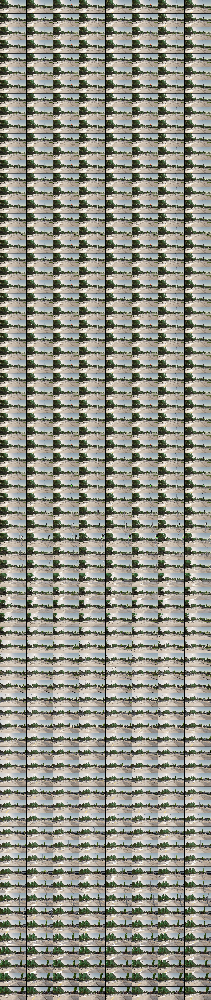

In [32]:
save_image(front[:, 1, :, :, :], 'sample_image.png')
JupyterImage('sample_image.png')

In [ ]:
#TODO put in inference, testing code here. 

### Testing model

In [12]:
m = VizCNN().to(device)
#m.load_state_dict(torch.load("m.torch"))
#m.eval()

In [13]:
sum([torch.numel(p) for p in m.parameters()]) / 1000

834.018

In [14]:
ix_0 = 0
ix_1 = 6

front = front_container[ix_0:ix_1, :, :, :, :].to(device)
aux = aux_container[ix_0:ix_1, :, :].to(device)
control = control_container[ix_0:ix_1, :, :].to(device)

In [15]:
front.shape, aux.shape

(torch.Size([6, 4, 3, 32, 32]), torch.Size([6, 4, 5]))

In [16]:
with torch.no_grad():
    out, hidden = m(front, aux, get_hidden(bs))

torch.Size([24, 576])


In [17]:
out.shape

torch.Size([6, 4, 2])